In [55]:
import tqdm
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
def string_para_float(numero):
    '''
    Transformação de colunas numéricas que utilizam indicador de milhar como '.'
    e decimal como ','
    '''
    numero = str(numero).replace('.', '')
    numero = numero.replace(',', '.')
    numero = float(numero)
    return numero

In [18]:
df_cad = pd.read_csv("./data/BD_Linhas-de-Transmissão(Cadastro).csv", encoding='latin-1', sep=';')
df_docs = pd.read_csv("./data/BD_Linhas-de-Transmissão(Documentos de Medição).csv", encoding='latin-1', sep=';')

df_cad = df_cad[df_cad['Latitude'] !=  '#N/D']

In [19]:
colunas_numericas = ['Valor teórico', 'LimInfIntMed.', 'LimSupIntMed.', 'ValMed/PosTCont']

for coluna in colunas_numericas:
    df_docs[coluna] = df_docs[coluna].apply(lambda x: string_para_float(x))


In [20]:
colunas_numericas = ['Latitude', 'Longitude']

for coluna in colunas_numericas:
    df_cad[coluna] = df_cad[coluna].apply(lambda x: string_para_float(x))


In [21]:
aux = df_cad[['Equipamento', 'Linha de Transmissão', 'Latitude', 'Longitude', 'Código ABC', 'Tensão']]
df_docs = df_docs.merge(aux, on='Equipamento')

df_docs['Ano'] = df_docs['Data'].apply(lambda x: x.split("/")[-1])

In [22]:
coords = df_cad[['Latitude','Longitude']].values

X_raw = coords.copy()

scaler = MinMaxScaler()
X_norm = scaler.fit_transform(coords)


In [23]:
# def testa_ks(X, ks=range(3,25)):
#     resultados = []
#     for k in tqdm.tqdm(ks):
#         km = KMeans(n_clusters=k, random_state=42, n_init='auto').fit(X)
#         inert = km.inertia_
#         sil = silhouette_score(X, km.labels_)
#         resultados.append({'k': k, 'inertia': inert, 'silhouette': sil})
#     return pd.DataFrame(resultados)

# res_raw  = testa_ks(X_raw)
# res_norm = testa_ks(X_norm)

In [24]:
# plt.figure(figsize=(12,4))

# plt.subplot(1,2,1)
# plt.plot(res_raw['k'], res_raw['inertia'], marker='o')
# plt.title('Elbow (raw)')
# plt.xlabel('k'); plt.ylabel('Inertia')

# plt.subplot(1,2,2)
# plt.plot(res_norm['k'], res_norm['inertia'], marker='o')
# plt.title('Elbow (normalizado)')
# plt.xlabel('k'); plt.ylabel('Inertia')

# plt.show()


In [38]:
k_best = 8
kmeans = KMeans(n_clusters=k_best, random_state=42)
df_cad['cluster_geo'] = kmeans.fit_predict(X_norm)

aux = df_cad[['Equipamento', 'Linha de Transmissão', 'Latitude', 'Longitude', 'Código ABC', 'Tensão', 'cluster_geo']]
df_docs = df_docs.merge(aux, on='Equipamento')

/home/andre/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [39]:
df_cad

,Equipamento,Linha de Transmissão,Denominação,Dt.entr.serviço,Classe,Código ABC,Tensão,Latitude,Longitude,cluster_geo
0,115280,LT31,Torre 111,NaN,L_TORRE_AUTOPORT,C,230,-22.977610,-50.056523,6
1,115281,LT31,Torre 112,NaN,L_TORRE_AUTOPORT,C,230,-22.979172,-50.053168,6
2,115282,LT31,Torre 113,NaN,L_TORRE_AUTOPORT,C,230,-22.980874,-50.049499,6
3,115283,LT31,Torre 114,NaN,L_TORRE_AUTOPORT,C,230,-22.983017,-50.044919,6
4,115284,LT31,Torre 115,NaN,L_TORRE_AUTOPORT,C,230,-22.984675,-50.041349,6
...,...,...,...,...,...,...,...,...,...,...
36224,248914,LT4272,Torre 001A,NaN,L_TORRE_AUTOPORT,C,345,-23.659804,-46.724611,1
36225,248915,LT4272,Torre 002A,NaN,L_TORRE_AUTOPORT,C,345,-23.657644,-46.724533,1
36226,295034,LT4272,Torre 055,NaN,L_TORRE_AUTOPORT,C,345,-23.527798,-46.753380,1
36227,302615,LT4272,Torre 000-P,NaN,L_PORTICO,C,345,-23.659282,-46.724309,1


/home/andre/anaconda3/lib/python3.11/site-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 23 is not valid for the current tile provider (valid zooms: 0 - 19).
  warnings.warn(msg)


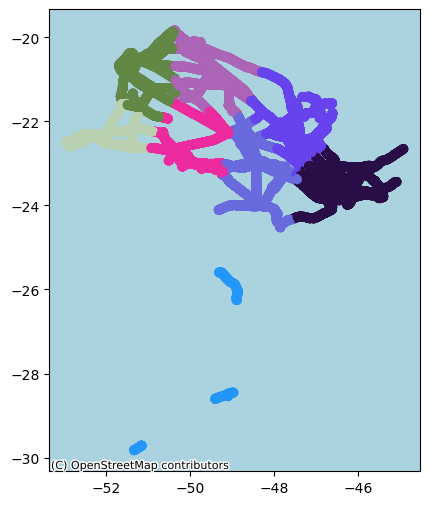

In [71]:
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt

gdf = gpd.GeoDataFrame(
    df_cad, geometry=gpd.points_from_xy(df_cad.Longitude, df_cad.Latitude))

colors =  [f"#{random.randint(0, 0xFFFFFF):06x}" for i in range(12)]

fig, ax = plt.subplots(figsize=(10, 6))
gdf.plot(ax=ax, color=gdf['cluster_geo'].map(lambda x: colors[int(x)]))
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)


In [82]:
import folium
import random
from folium.plugins import MarkerCluster
from branca.element import Figure


fig = Figure(width=600, height=400)
map_center = [df_cad['Latitude'].mean(), df_cad['Longitude'].mean()]
m = folium.Map(location=map_center, zoom_start=6)

colors =  [f"#{random.randint(0, 0xFFFFFF):06x}" for i in range(12)]


for idx, row in list(df_cad.iterrows())[:]:
    folium.CircleMarker(
        location=(row['Latitude'], row['Longitude']),
        radius=3,
        color=colors[int(row['cluster_geo'])],
        fill=True,
        fill_color=colors[int(row['cluster_geo'])],
        fill_opacity=0.7,
        popup=f"Cluster: {row['cluster_geo']}"
    ).add_to(m)


# fig.add_child(m)
iframe = m._repr_html_()

In [83]:
from IPython.display import HTML
display(HTML(iframe))

In [59]:
df_docs

,Equipamento,Ponto medição,Doc.medição,Data,Item medição,Valor teórico,LimInfIntMed.,LimSupIntMed.,ValMed/PosTCont,Unid.caracter.,...,Código ABC_x,Tensão_x,Ano,Linha de Transmissão_y,Latitude_y,Longitude_y,Código ABC_y,Tensão_y,cluster_geo,oob
0,294939,9283819,4757784,2023-05-05,CABO CONDUTOR,0.0,0.0,6.0,0.0,UN,...,C,230,2023,LT98,-22.764303,-45.087492,C,230,1,False
1,294939,9283757,7983160,2025-02-18,TORRE,NaN,0.0,NaN,5.0,UN,...,C,230,2025,LT98,-22.764303,-45.087492,C,230,1,False
2,294939,9283757,3692788,2022-02-02,TORRE,NaN,0.0,NaN,9.0,UN,...,C,230,2022,LT98,-22.764303,-45.087492,C,230,1,False
3,294938,9283651,4757781,2023-05-05,CABO CONDUTOR,0.0,0.0,6.0,0.0,UN,...,C,230,2023,LT98,-22.868736,-45.254782,C,230,1,False
4,294938,9283589,7983161,2025-02-18,TORRE,NaN,0.0,NaN,4.0,UN,...,C,230,2025,LT98,-22.868736,-45.254782,C,230,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
308130,101848,6554301,7839101,2025-01-10,VÃO,0.0,0.0,100.0,6000.0,m2,...,C,88,2025,LT3235,-23.124844,-49.727414,C,88,6,True
308131,101848,6554301,7668321,2024-12-09,VÃO,0.0,0.0,100.0,0.0,m2,...,C,88,2024,LT3235,-23.124844,-49.727414,C,88,6,False
308132,101848,6554301,4549065,2023-02-23,VÃO,0.0,0.0,100.0,6600.0,m2,...,C,88,2023,LT3235,-23.124844,-49.727414,C,88,6,True
308133,101818,4479613,795613,2018-10-19,CABO CONDUTOR,0.0,0.0,6.0,1.0,UN,...,C,88,2018,LT3235,-22.997310,-49.852595,C,88,6,False


In [60]:
aux_analisys = df_docs[df_docs['Item medição'] != "TORRE"]

Text(0.5, 1.0, 'Relação entre medições por torres e cluster de geolocalização')

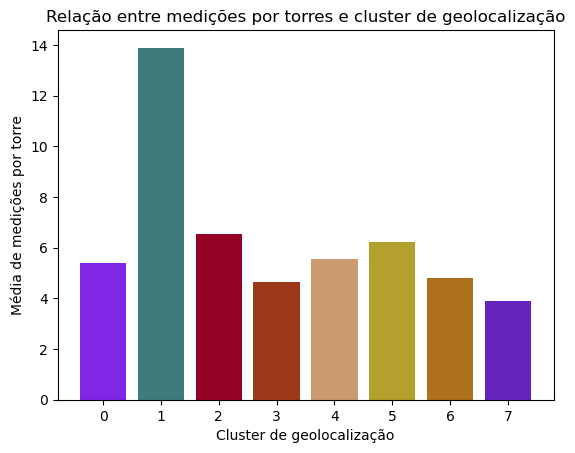

In [131]:
medicoes = aux_analisys.groupby(['cluster_geo']).count()['Equipamento']/df_cad.groupby(['cluster_geo']).count()['Equipamento']

plt.bar(x=medicoes.index, height=medicoes.values, color=colors[:8])
plt.xlabel("Cluster de geolocalização")
plt.ylabel("Média de medições por torre")
plt.title("Relação entre medições por torres e cluster de geolocalização")


In [ ]:
aux_analisys['Texto_onlynumber'] = aux_analisys['Texto']

In [116]:
aux_analisys2 = aux_analisys[~aux_analisys['Texto'].isna()]
aux_analisys2 = aux_analisys2[aux_analisys2['Texto'].str.isnumeric()]

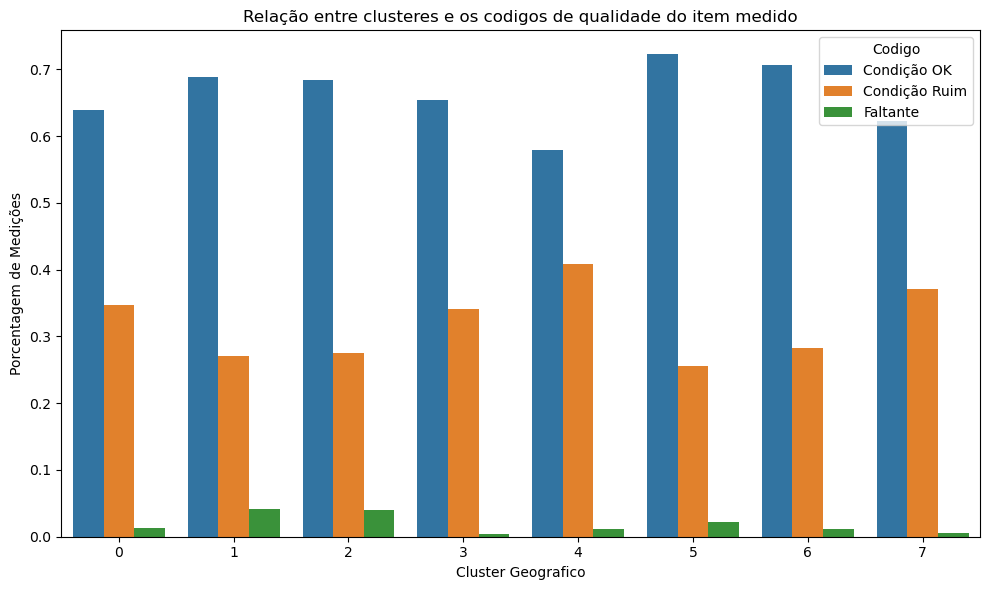

In [141]:
df = aux_analisys2.copy()
df = df[df['Texto'] != '0']

mapping = {**{str(i): 'Condição Ruim' for i in range(0,5)}, 
           '5': 'Condição OK',
           '9': 'Faltante'}

df['Texto_group'] = df['Texto'].map(mapping)
df = df.dropna(subset=['Texto_group'])

total_per_cluster = df.groupby('cluster_geo')['Equipamento'].count()

counts = df.groupby(['Texto_group', 'cluster_geo'])['Equipamento'].count()

pct = (counts / total_per_cluster).reset_index(name='percentage')

plt.figure(figsize=(10, 6))
sns.barplot(
    data=pct,
    x='cluster_geo',
    y='percentage',
    hue='Texto_group',
)
plt.xlabel('Cluster Geografico')
plt.ylabel('Porcentagem de Medições')
plt.title('Relação entre clusteres e os codigos de qualidade do item medido')
plt.xticks(sorted(df['cluster_geo'].unique()))
plt.legend(title='Codigo')
plt.tight_layout()
plt.show()

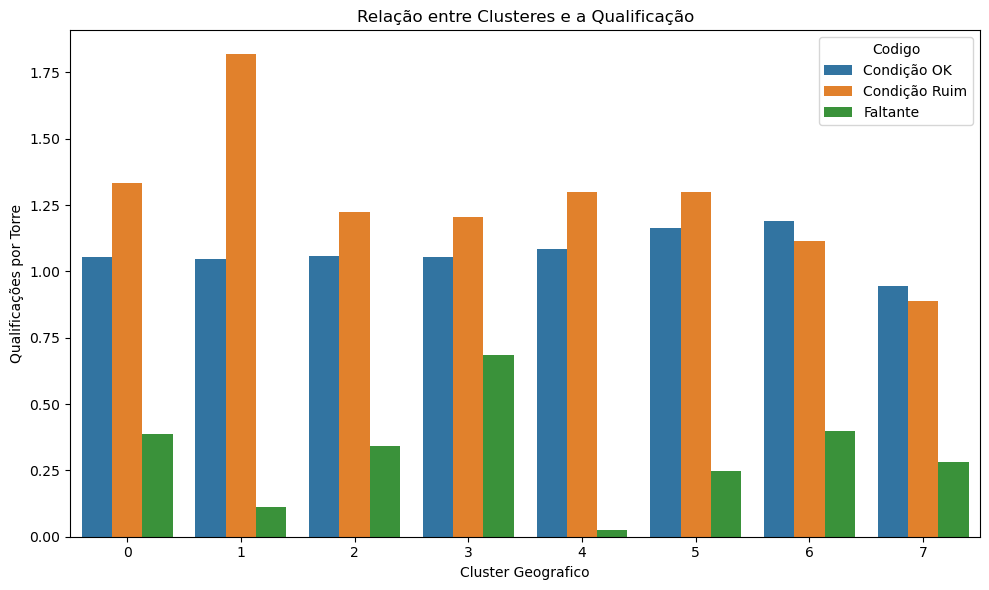

In [170]:
aux_analisys_torre = df_docs[df_docs['Item medição'] == 'TORRE']
aux_analisys_torre.groupby(['cluster_geo', 'ValMed/PosTCont']).count()


df = aux_analisys_torre.copy()

mapping = {**{i: 'Condição Ruim' for i in range(0,5)}, 
           5: 'Condição OK',
           9: 'Faltante'}

df['ValMed/PosTCont'] = df['ValMed/PosTCont'].map(mapping)

total_per_cluster = df_cad.groupby('cluster_geo')['Equipamento'].count()

counts = df.groupby(['cluster_geo', 'ValMed/PosTCont'])['Equipamento'].count()

pct = (counts/total_per_cluster).reset_index(name='percentage')

plt.figure(figsize=(10, 6))
sns.barplot(
    data=pct,
    x='cluster_geo',
    y='percentage',
    hue='ValMed/PosTCont',
)
plt.xlabel('Cluster Geografico')
plt.ylabel('Qualificações por Torre')
plt.title('Relação entre Clusteres e a Qualificação')
plt.xticks(sorted(df['cluster_geo'].unique()))
plt.legend(title='Codigo')
plt.tight_layout()
plt.show()

In [174]:
denominacao_map = {
    "CORRO.": "CORROSÃO",
    "CORROSAO": "CORROSÃO",
    "CORROS": "CORROSÃO",
    "ISOL": "ISOL",
    "ESPACADOR": "ESPAÇADOR",
    "RABICHO": "RABICHO",
    "PECAS": "PEÇAS",
    "PECA": "PEÇAS",
    "ROCADA": "ROÇADA",
    "PARA-RAIO": "PARA-RAIO",
    "FERRAGENS": "FERRAGENS",
    "FERRAG": "FERRAGENS",
    "CABO CONDUTOR": "CABO CONDUTOR",
    "ESFERA": "ESFERA",
    "TENTO ROMPIDO": "TENTO ROMPIDO",
    "TENTO": "TENTO ROMPIDO",
    "AMORTECEDOR CONDUTOR": "AMORTECEDOR CONDUTOR",
    "JUMPER": "JUMPER",
    "EMENDA": "EMENDA",
    "TEMP": "TEMP",
    "GRAMPO DE SUSPENSAO CONDUTOR": "GRAMPO DE SUSPENSAO CONDUTOR",
    "BOBINA DE BLOQUEIO": "BOBINA DE BLOQUEIO",
    "CARGA RUPTURA": "CARGA RUPTURA",
    "GRAMPO DE ANCORAGEM CONDUTOR": "GRAMPO DE ANCORAGEM CONDUTOR",
    "PROTEÇÃO": "PROTEÇÃO (CHIFRE / ANEL)",
}

def process_denominacao(x):
    for key in denominacao_map:
        if key in x:
            return denominacao_map[key].upper()
    return x.upper()

aux_analisys['denominação_processed'] = aux_analisys['Denominação'].apply(lambda x: process_denominacao(x))

/tmp/ipykernel_371297/2592225308.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aux_analisys['denominação_processed'] = aux_analisys['Denominação'].apply(lambda x: process_denominacao(x))


In [177]:
counts = (
    aux_analisys
      .groupby(['cluster_geo','denominação_processed'])
      .size()
      .reset_index(name='counts')
)

idx = counts.groupby('cluster_geo')['counts'].idxmax()

max_per_cluster = counts.loc[idx].reset_index(drop=True)

print(max_per_cluster)

   cluster_geo denominação_processed  counts
0            0                ROÇADA   10162
1            1              CORROSÃO   32521
2            2                ROÇADA    9469
3            3                ROÇADA    5101
4            4             BASE SUJA     731
5            5                ROÇADA   11212
6            6                ROÇADA    5202
7            7                ROÇADA    6606


In [233]:
import pandas as pd
import matplotlib.pyplot as plt

K = 3
counts = (
    aux_analisys
      .groupby(['cluster_geo', 'denominação_processed'])
      .size()
      .reset_index(name='counts')
)
topk = (
    counts
      .sort_values(['cluster_geo','counts'], ascending=[True, False])
      .groupby('cluster_geo')
      .head(K)
      .reset_index(drop=True)
)

pivot = topk.pivot(
    index='cluster_geo',
    columns='denominação_processed',
    values='counts'
).fillna(0)




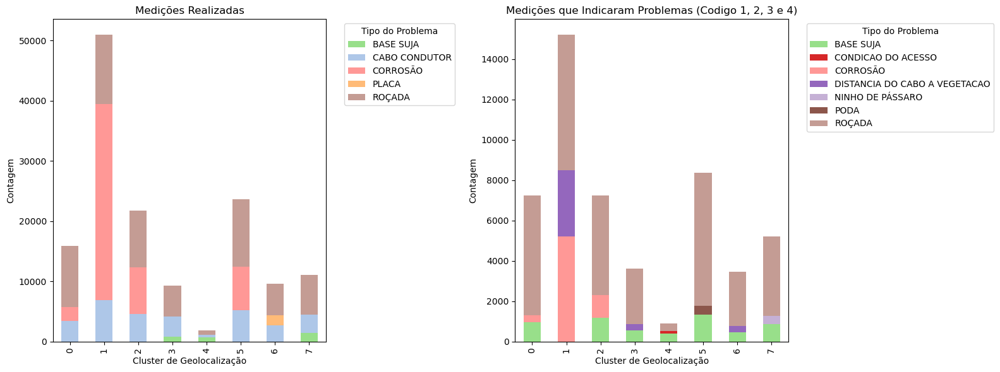

In [235]:
aux_problemas = aux_analisys[aux_analisys['Texto']!=('5')]
aux_problemas = aux_problemas[aux_problemas['Texto']!=('9')]


K = 3
counts2 = (
    aux_problemas
      .groupby(['cluster_geo', 'denominação_processed'])
      .size()
      .reset_index(name='counts')
)
topk2 = (
    counts2
      .sort_values(['cluster_geo','counts'], ascending=[True, False])
      .groupby('cluster_geo')
      .head(K)
      .reset_index(drop=True)
)

pivot2 = topk2.pivot(
    index='cluster_geo',
    columns='denominação_processed',
    values='counts'
).fillna(0)


labels = list(pivot.columns)+list(pivot2.columns)

palette = dict(zip(
    labels,
    sns.color_palette("tab20", n_colors=len(labels))
))

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6), sharey=False)

# left subplot: pivot2
pivot2.plot(
    kind='bar',
    ax=axes[1],
    color=[palette[col] for col in pivot2.columns], stacked=True,
)
axes[1].set_xlabel('Cluster de Geolocalização')
axes[1].set_ylabel('Contagem')
axes[1].set_title(f'Medições que Indicaram Problemas (Codigo 1, 2, 3 e 4)')
axes[1].legend(title='Tipo do Problema', bbox_to_anchor=(1.05, 1), loc='upper left')

# right subplot: pivot
pivot.plot(
    kind='bar',
    ax=axes[0],
    color=[palette[col] for col in pivot.columns], stacked=True,
)
axes[0].set_xlabel('Cluster de Geolocalização')
axes[0].set_ylabel('Contagem')
axes[0].set_title(f'Medições Realizadas')
axes[0].legend(title='Tipo do Problema', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()

In [237]:
df_docs#[df_docs['Texto'].str.contains("CORROSÃO")]

,Equipamento,Ponto medição,Doc.medição,Data,Item medição,Valor teórico,LimInfIntMed.,LimSupIntMed.,ValMed/PosTCont,Unid.caracter.,...,Código ABC_x,Tensão_x,Ano,Linha de Transmissão_y,Latitude_y,Longitude_y,Código ABC_y,Tensão_y,cluster_geo,oob
0,294939,9283819,4757784,2023-05-05,CABO CONDUTOR,0.0,0.0,6.0,0.0,UN,...,C,230,2023,LT98,-22.764303,-45.087492,C,230,1,False
1,294939,9283757,7983160,2025-02-18,TORRE,NaN,0.0,NaN,5.0,UN,...,C,230,2025,LT98,-22.764303,-45.087492,C,230,1,False
2,294939,9283757,3692788,2022-02-02,TORRE,NaN,0.0,NaN,9.0,UN,...,C,230,2022,LT98,-22.764303,-45.087492,C,230,1,False
3,294938,9283651,4757781,2023-05-05,CABO CONDUTOR,0.0,0.0,6.0,0.0,UN,...,C,230,2023,LT98,-22.868736,-45.254782,C,230,1,False
4,294938,9283589,7983161,2025-02-18,TORRE,NaN,0.0,NaN,4.0,UN,...,C,230,2025,LT98,-22.868736,-45.254782,C,230,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
308130,101848,6554301,7839101,2025-01-10,VÃO,0.0,0.0,100.0,6000.0,m2,...,C,88,2025,LT3235,-23.124844,-49.727414,C,88,6,True
308131,101848,6554301,7668321,2024-12-09,VÃO,0.0,0.0,100.0,0.0,m2,...,C,88,2024,LT3235,-23.124844,-49.727414,C,88,6,False
308132,101848,6554301,4549065,2023-02-23,VÃO,0.0,0.0,100.0,6600.0,m2,...,C,88,2023,LT3235,-23.124844,-49.727414,C,88,6,True
308133,101818,4479613,795613,2018-10-19,CABO CONDUTOR,0.0,0.0,6.0,1.0,UN,...,C,88,2018,LT3235,-22.997310,-49.852595,C,88,6,False
